In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import yaml
import os
import csv
from sklearn.metrics import confusion_matrix
from tqdm.notebook import tqdm
import pandas as pd
import seaborn as sns
import sys
from torchmetrics import ConfusionMatrix
from torchmetrics.classification import F1Score, Accuracy, Precision, Recall
sys.path.append('../')
from datamodule.datamodule import select_data

In [94]:
print(plt.style.available)
plt.style.use('seaborn-v0_8-dark-palette')

['Solarize_Light2', '_classic_test_patch', '_mpl-gallery', '_mpl-gallery-nogrid', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn-v0_8', 'seaborn-v0_8-bright', 'seaborn-v0_8-colorblind', 'seaborn-v0_8-dark', 'seaborn-v0_8-dark-palette', 'seaborn-v0_8-darkgrid', 'seaborn-v0_8-deep', 'seaborn-v0_8-muted', 'seaborn-v0_8-notebook', 'seaborn-v0_8-paper', 'seaborn-v0_8-pastel', 'seaborn-v0_8-poster', 'seaborn-v0_8-talk', 'seaborn-v0_8-ticks', 'seaborn-v0_8-white', 'seaborn-v0_8-whitegrid', 'tableau-colorblind10']


In [117]:
path_results = '../../results/coop_sim2real_MNIST_bench_image/'
version = 'version_6'

In [122]:
csv_filename = os.path.join(path_results, version, 'logs', 'metrics.csv')
metrics = {}
with open(csv_filename) as csvfile:
    reader = csv.reader(csvfile, delimiter=',')
    for i,row in enumerate(reader):
        if i == 0:
            for header in row:
                metrics[header] = []
            key_list = list(metrics.keys())
        else:
            for j,value in enumerate(row):
                metrics[key_list[j]].append(value)

In [123]:
print(metrics.keys())

dict_keys(['bench_to_ideal_train', 'bench_to_ideal_val', 'classifier_loss_train', 'classifier_loss_val', 'epoch', 'loss_train', 'loss_val', 'sim_to_bench_train', 'sim_to_bench_val', 'sim_to_ideal_train', 'sim_to_ideal_val', 'step'])


In [124]:
# Clean up the metrics
for key,value in metrics.items():
    if key == 'epoch':
        metrics[key] = np.unique(np.asarray(value, dtype=int))
    elif key == 'step':
        pass
    else:
        metrics[key] = [float(i) for i in value if i != '']

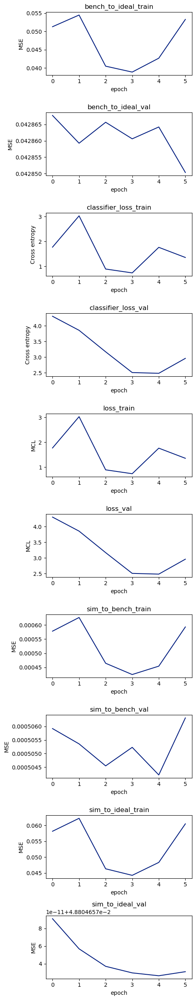

In [125]:
# Let's just plot all of the metrics in their own plots

fig, ax = plt.subplots(len(metrics.keys()) - 2, 1, figsize=(5,25))

counter = 0
for key, value in metrics.items():
    if key == 'epoch' or key == 'step':
        pass
    else:
        ax[counter].plot(metrics['epoch'], metrics[key])
        ax[counter].set_title(key)
        ax[counter].set_xlabel('epoch')
        if 'classifier' in key:
            ax[counter].set_ylabel("Cross entropy")
        elif key == 'loss_train' or key == 'loss_val':
            ax[counter].set_ylabel("MCL")
        else:
            ax[counter].set_ylabel("MSE")
        counter +=1
plt.tight_layout()

In [126]:
# Now let's look at the lens phases
path_lens_phase = os.path.join(path_results, version, 'lens_phase')
files = os.listdir(path_lens_phase)
files = [os.path.join(path_lens_phase, i) for i in files]

In [50]:
test = torch.load(files[0], weights_only=True)

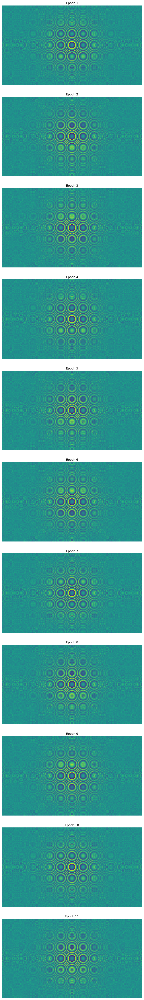

In [51]:
fig,ax = plt.subplots(len(files), 1, figsize=(8, 5 * len(files)))

for i,f in enumerate(files):
    phases = torch.load(f, weights_only=True)
    ax[i].imshow(torch.exp(1j*phases.detach().cpu().squeeze()).angle().numpy())
    ax[i].axis('off')
    ax[i].set_title(f"Epoch {i+1}")

plt.tight_layout()

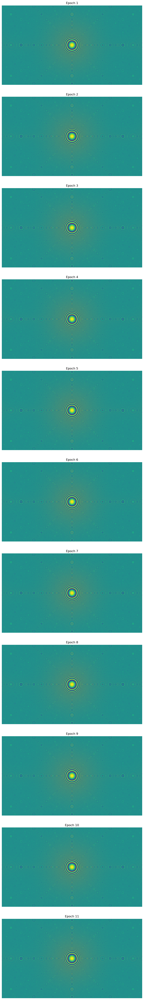

In [53]:
fig,ax = plt.subplots(len(files), 1, figsize=(8, 5 * len(files)))

for i,f in enumerate(files):
    phases = torch.load(f, weights_only=True)
    ax[i].imshow(phases.detach().cpu().squeeze() % (2 * torch.pi))
    ax[i].axis('off')
    ax[i].set_title(f"Epoch {i+1}")

plt.tight_layout()

In [54]:
test = torch.load(files[-1], weights_only=True)

In [55]:
test1 = test.detach().cpu() % (2 * torch.pi)
test2 = torch.exp(1j * test).angle().detach().cpu() + torch.pi

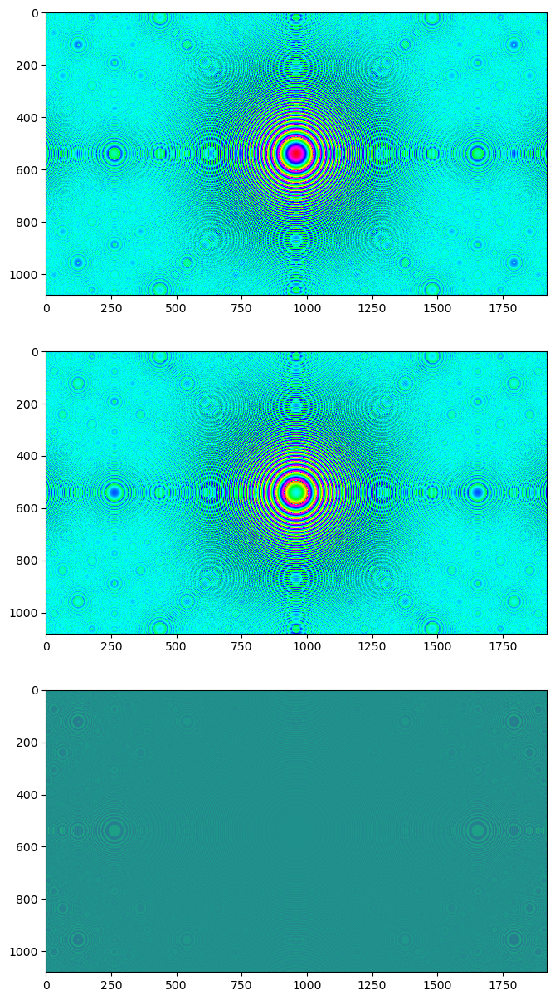

In [56]:
fig,ax = plt.subplots(3, 1, figsize=(8, 15))

ax[0].imshow(test1, cmap='hsv', vmin=0, vmax=2*np.pi)
ax[1].imshow(test2, cmap='hsv', vmin=0, vmax=2*np.pi)
ax[2].imshow(torch.abs(test1-test2))

In [57]:
print(torch.max(test1))
print(torch.min(test1))
print(torch.max(test2))
print(torch.min(test2))
print(torch.max(test1-test2))
print(torch.min(test1-test2))

tensor(6.2832, dtype=torch.float64)
tensor(1.4814e-07, dtype=torch.float64)
tensor(6.2832, dtype=torch.float64)
tensor(1.3588e-06, dtype=torch.float64)
tensor(3.1416, dtype=torch.float64)
tensor(-3.1416, dtype=torch.float64)
